# DDPLKO Moduł 8 - praca domowa - Analiza działania modelu

To ósma praca domowa w Programie szkoleniowym Klasyfikacja obrazu od Deep Drive PL

Twoim zadaniem w tym module będzie - w zależności od dostępnej mocy obliczniowej:
1. Na bazie pracy domowej z Transfer learningiem, data augmentation
2. Na bazie pracy domowej ze zbiorem **QuickDraw**

Wykonanie dla próbek w których model się pomylił podczas predykcji:
- [ ] Wizualizacji Occlusion sensitivy
- [ ] oraz GradCAM/Guided GradCAM
- [ ] Udostępnij przykładowy wynik na Discordzie `#klasyfikacja-wyniki` (wystarczy dla 1 zdjęcia)

Możesz extra (czyli opcjonalne rzeczy):
- Zwizualizować zbiór Val wykorzystując t-SNE/UMAP/MDE

## Dane

In [1]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import cv2

import PIL
from torchvision import transforms

import seaborn as sns
sns.set(style='whitegrid',font_scale=1.5)

from torchvision.models import resnet50

import tensorflow_datasets as tfds

for gpu in tf.config.list_physical_devices('GPU'):
    tf.config.experimental.set_memory_growth(gpu, True)

In [2]:
(ds_train, ds_val),info = tfds.load(
    "resisc45",
    split=["train[:70%]", "train[70%:100%]"],
    as_supervised=True,  # Include labels
    with_info=True
)

print('Train:',len(ds_train))
print('Val:',len(ds_val))

Train: 22050
Val: 9450


In [3]:
class_names = info.features['label'].names

num_classes = len(class_names)
num_classes

45

2 (256, 256, 3) tf.Tensor(11, shape=(), dtype=int64)


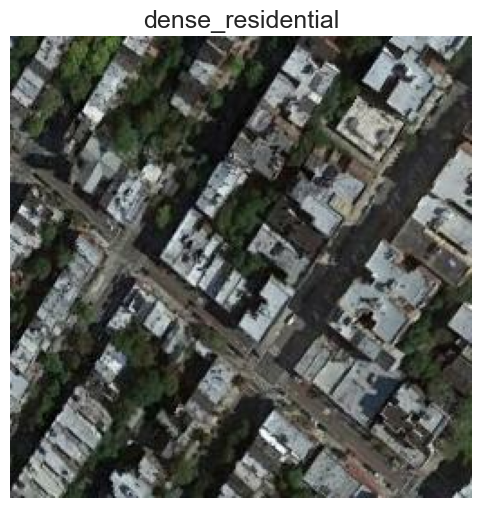

In [4]:
plt.figure(figsize=(6,6))
for i,_ in enumerate(ds_train.take(1)):
    print(len(_),_[0].shape,_[1])
    img = (_[0])
    plt.imshow(img)
    plt.title(class_names[_[1]])
    plt.axis('off')
    plt.show();

In [5]:
img1 = img

In [6]:
# niestety po zresizowaniu wyświetla się jako szum gaussowski (patrz komórki poniżej)
img = tf.image.resize(img, (224,224))

In [7]:
# konwersja tensora do obrazka, ściąga poniżej
# https://cloudxlab.com/assessment/displayslide/5658/converting-tensor-to-image

def tensor_to_image(tensor):
    tensor = tensor*255
    tensor = np.array(tensor, dtype=np.uint8)
    if np.ndim(tensor)>3:
        assert tensor.shape[0] == 1
        tensor = tensor[0]
    return PIL.Image.fromarray(tensor)

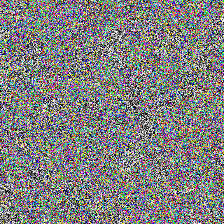

In [8]:
obrazek = tensor_to_image(img)

# próbowałam zmienić rozmiar i przekształcić kolory dla tego obrazka (sypie błędami)
# obrazek = cv2.cvtColor(obrazek, cv2.COLOR_BGR2RGB)
# obrazek = cv2.resize(obrazek, (224,224))

obrazek

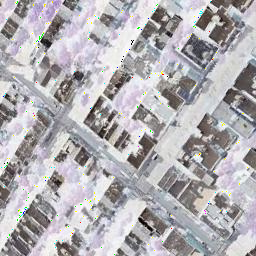

In [9]:
obrazek1 = tensor_to_image(img1)
obrazek1


# Occlusion sensitivity

In [10]:
# lekcja 08.05

from tf_explain.core import OcclusionSensitivity
from tf_explain.callbacks.occlusion_sensitivity import OcclusionSensitivityCallback
from tf_explain.utils.display import heatmap_display

from captum.attr import Occlusion
from captum.attr import visualization as viz

In [11]:
# z lekcji 8.04 zmiana shape 

In [12]:
img = tf.keras.preprocessing.image.img_to_array(img)
img = tf.image.resize(img, (224,224))
print('Image:',img.shape) 
x = np.expand_dims(img, axis=0)
print('Image:',x.shape)

Image: (224, 224, 3)
Image: (1, 224, 224, 3)


In [13]:
model = tf.keras.applications.ResNet50()

input_ = tf.keras.applications.resnet50.preprocess_input(img)
output = model(tf.expand_dims(input_, 0))

In [14]:
model = resnet50(pretrained=True)
model.eval()

transform = transforms.Compose([transforms.ToTensor(),
                                transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])])

input_tensor = transform(obrazek)
input_batch = input_tensor.unsqueeze(0)
output = model(input_batch)

C:\ProgramData\Anaconda3\lib\site-packages\torch\nn\functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  ..\c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


In [15]:
strides = (1, 60, 60)
sliding_window_shapes = (1, 100, 100)
baselines = 0

In [16]:
true_index = 11
class_names[true_index]

'dense_residential'

In [17]:
occlusion = Occlusion(model)
attributions = occlusion.attribute(input_batch,
                                   strides=strides,
                                   target=true_index,
                                   sliding_window_shapes=sliding_window_shapes,
                                   baselines=baselines,
                                   show_progress=True)

Occlusion attribution: 100%|███████████████████████████████████████████████████████████| 49/49 [00:04<00:00, 11.31it/s]


In [18]:
attributions.shape, attributions.dtype

(torch.Size([1, 3, 224, 224]), torch.float32)

In [19]:
# zmiana do celów wizualizacji
attributions = np.transpose(attributions.squeeze().cpu().detach().numpy(), (1, 2, 0))
attributions.shape, attributions.dtype

((224, 224, 3), dtype('float32'))

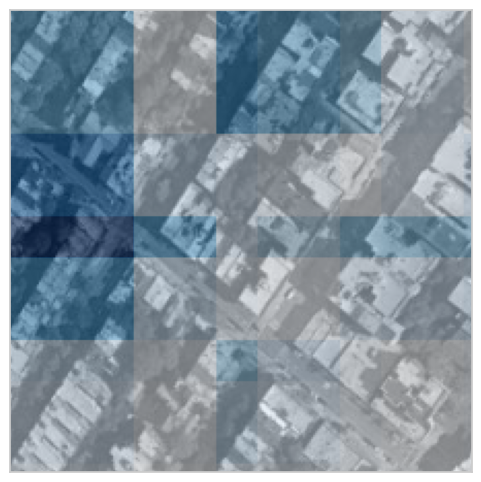

In [20]:
viz.visualize_image_attr(attributions, img, 'blended_heat_map')
plt.show();

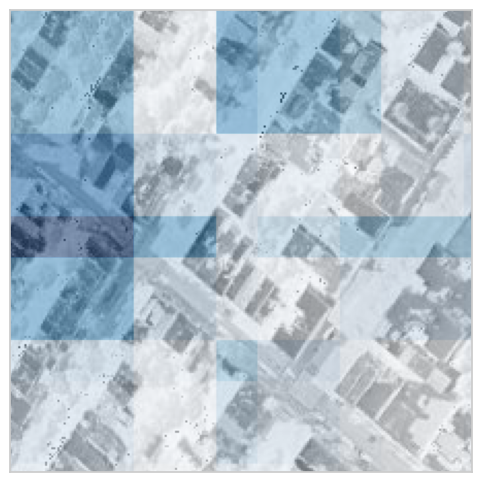

In [23]:
# jakby się wyświetlanie rozjechjało przeładować jeszcze raz komórkę
viz.visualize_image_attr(attributions, obrazek1, 'blended_heat_map')
plt.show();

In [25]:
def read_show_img(path):
    image = cv2.imread(path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = cv2.resize(image, (224,224))

    plt.figure(figsize=(9,9))
    plt.imshow(image)
    plt.axis('off')
    
    return image

In [26]:
imagejpg = read_show_img('images/dense_residential_068.jpg')

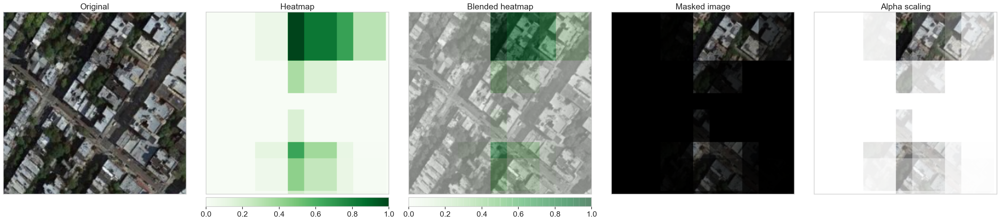

In [29]:
methods = {'methods': ['original_image', 'heat_map', 'blended_heat_map', 'masked_image', 'alpha_scaling'],
           'titles': ['Original', 'Heatmap', 'Blended heatmap', 'Masked image', 'Alpha scaling']}

signs_positive = {'signs': ['all', 'positive', 'positive', 'positive', 'positive']} #positive pixel attributions

plot_kwargs = {'show_colorbar': True,
               'fig_size': (30,10)}

viz.visualize_image_attr_multiple(attributions, imagejpg, **methods, **signs_positive, **plot_kwargs)
plt.show(); # dodałam tę linijkę bo mi się wykres rozjeżdża

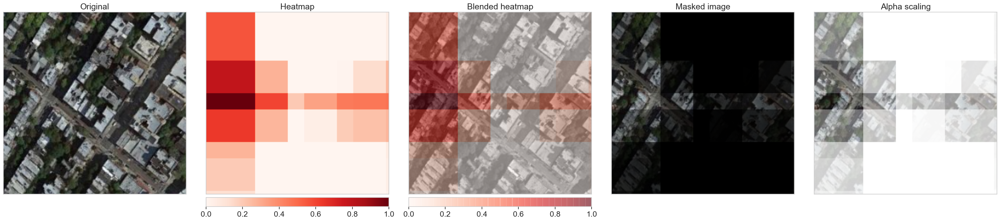

In [28]:
signs_negative = {'signs': ['all', 'negative', 'negative', 'negative', 'negative']} #negative pixel attributions

viz.visualize_image_attr_multiple(attributions, imagejpg, **methods, **signs_negative, **plot_kwargs)
plt.show();

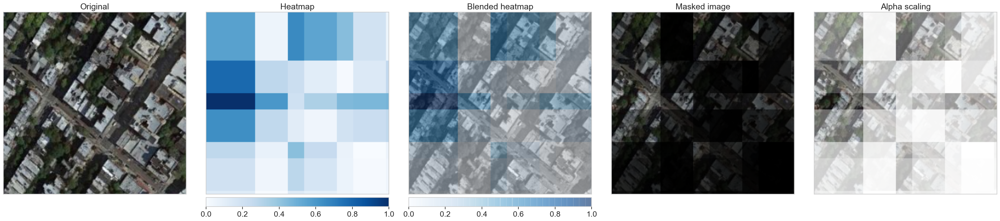

In [30]:
signs_absolute = {'signs': ['all', 'absolute_value', 'absolute_value', 'absolute_value', 'absolute_value']} #absolute value of attributions

viz.visualize_image_attr_multiple(attributions, imagejpg, **methods, **signs_absolute, **plot_kwargs)
plt.show();

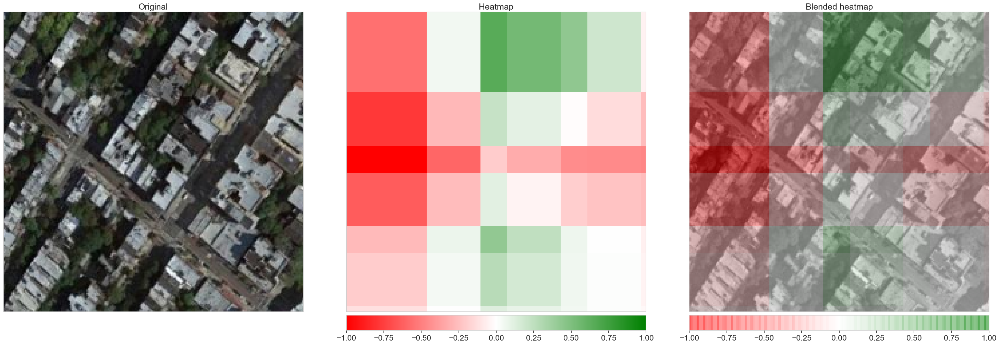

In [31]:
methods_ = {'methods': ['original_image', 'heat_map', 'blended_heat_map'],
           'titles': ['Original', 'Heatmap', 'Blended heatmap']}

signs_all = {'signs': ['all', 'all', 'all']} #all pixel attributions - not supported for masked_image and alpha_scaling modes

viz.visualize_image_attr_multiple(attributions, imagejpg, **methods_, **signs_all, **plot_kwargs)
plt.show();

In [32]:
# dla innej klasy

In [33]:
target = 1
print(class_names[target])

attributions = occlusion.attribute(input_batch, strides=strides, target=target, sliding_window_shapes=sliding_window_shapes, baselines=baselines, show_progress=True)
attributions = np.transpose(attributions.squeeze().cpu().detach().numpy(), (1, 2, 0))

Occlusion attribution:   0%|                                                                    | 0/49 [00:00<?, ?it/s]

airport


Occlusion attribution: 100%|███████████████████████████████████████████████████████████| 49/49 [00:04<00:00, 11.10it/s]


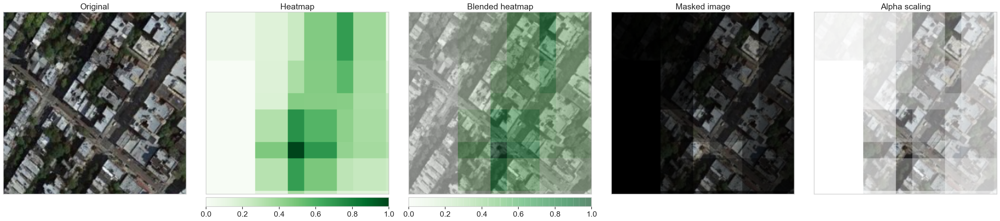

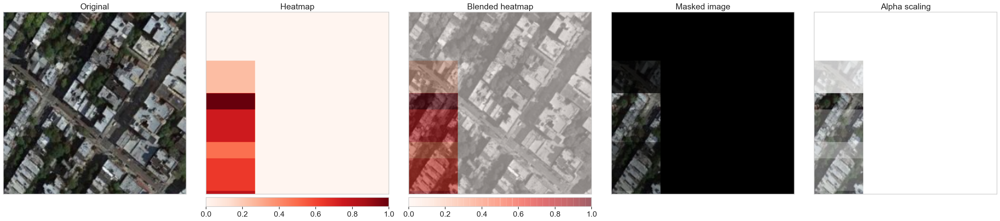

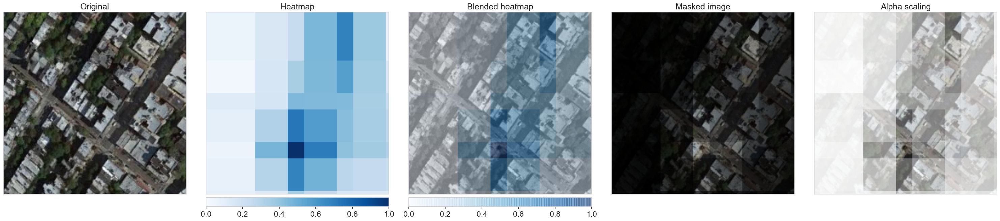

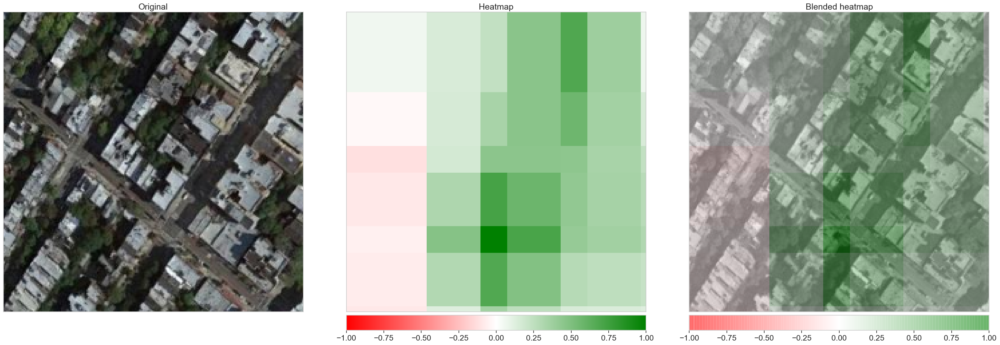

In [34]:
viz.visualize_image_attr_multiple(attributions, imagejpg, **methods, **signs_positive, **plot_kwargs)
viz.visualize_image_attr_multiple(attributions, imagejpg, **methods, **signs_negative, **plot_kwargs)
viz.visualize_image_attr_multiple(attributions, imagejpg, **methods, **signs_absolute, **plot_kwargs)
viz.visualize_image_attr_multiple(attributions, imagejpg, **methods_, **signs_all, **plot_kwargs);

# (Guided) GradCAM

In [35]:
from captum.attr import LayerGradCam, LayerAttribution, GuidedGradCam

In [38]:
def preprocess(img):
    transform = transforms.Compose([transforms.ToTensor(),
                                    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])])

    input_tensor = transform(img)
    input_batch = input_tensor.unsqueeze(0)
    
    return input_batch

In [41]:
model = resnet50(pretrained=True)
model.eval()

input_batch = preprocess(obrazek)
output = model(input_batch)

In [43]:
## GradCAM

target = 11 # nazwa własna nie weszła ale numer klasy owszem
gradcam = LayerGradCam(model, model.layer4[-1])
attributions_ = gradcam.attribute(input_batch, target=target)

attributions_.shape, attributions_.dtype

(torch.Size([1, 1, 7, 7]), torch.float32)

In [47]:
attributions = LayerAttribution.interpolate(attributions_, (imagejpg.shape[0], imagejpg.shape[1]))

In [48]:
attributions = np.transpose(attributions.squeeze(0).cpu().detach().numpy(), (1, 2, 0))
attributions.shape, attributions.dtype

((224, 224, 1), dtype('float32'))

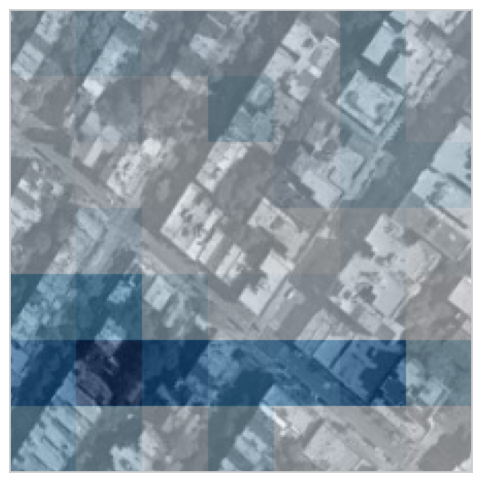

In [50]:
viz.visualize_image_attr(attributions, imagejpg, 'blended_heat_map')
plt.show();

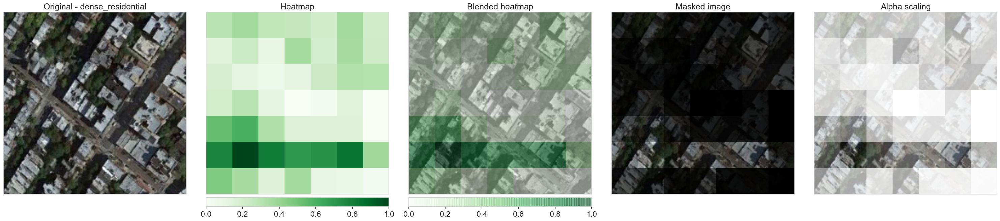

In [53]:
methods = {'methods': ['original_image', 'heat_map', 'blended_heat_map', 'masked_image', 'alpha_scaling']}
signs_positive = {'signs': ['all', 'positive', 'positive', 'positive', 'positive']} #positive pixel attributions
titles = ['Heatmap', 'Blended heatmap', 'Masked image', 'Alpha scaling']
plot_kwargs = {'show_colorbar': True, 'fig_size': (30,10)}

viz.visualize_image_attr_multiple(attributions, imagejpg, **methods, **signs_positive, **plot_kwargs, titles=['Original - ' + class_names[target], *titles])
plt.show();

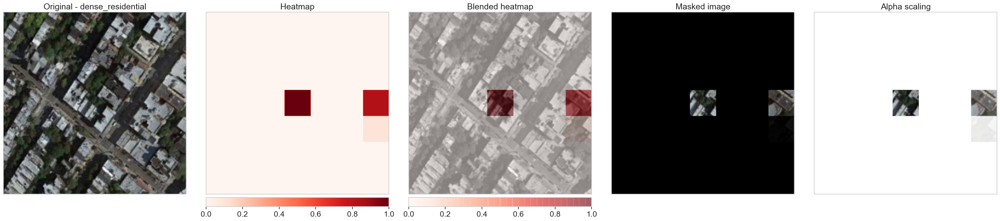

In [54]:
signs_negative = {'signs': ['all', 'negative', 'negative', 'negative', 'negative']} #negative pixel attributions

viz.visualize_image_attr_multiple(attributions, imagejpg, outlier_perc=2, **methods, **signs_negative, **plot_kwargs, titles=['Original - ' + class_names[target], *titles])
plt.show();

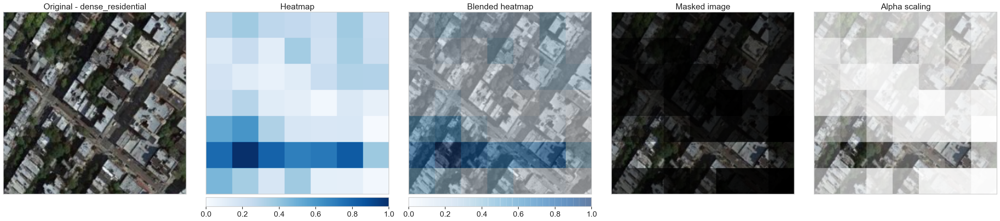

In [56]:
signs_absolute = {'signs': ['all', 'absolute_value', 'absolute_value', 'absolute_value', 'absolute_value']} #absolute value of attributions

viz.visualize_image_attr_multiple(attributions, imagejpg, **methods, **signs_absolute, **plot_kwargs, titles=['Original - ' + class_names[target], *titles])
plt.show();

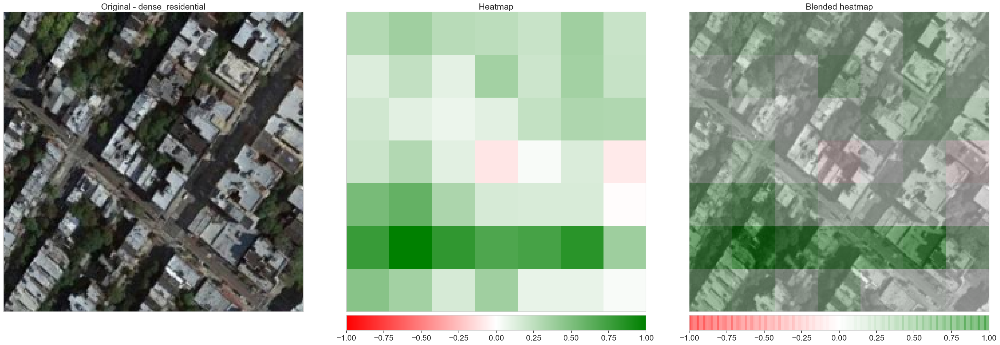

In [58]:
methods_ = {'methods': ['original_image', 'heat_map', 'blended_heat_map']}
signs_all = {'signs': ['all', 'all', 'all']} #all pixel attributions - not supported for masked_image and alpha_scaling modes
titles_ = ['Heatmap', 'Blended heatmap']

viz.visualize_image_attr_multiple(attributions, imagejpg, **methods_, **signs_all, **plot_kwargs, titles=['Original - ' + class_names[target], *titles_])
plt.show();

In [66]:
target = 11
class_names[target]

'dense_residential'

In [67]:
attributions_ = gradcam.attribute(input_batch, target=target)
attributions = LayerAttribution.interpolate(attributions_, (imagejpg.shape[0], imagejpg.shape[1]))
attributions = np.transpose(attributions.squeeze(0).cpu().detach().numpy(), (1, 2, 0))

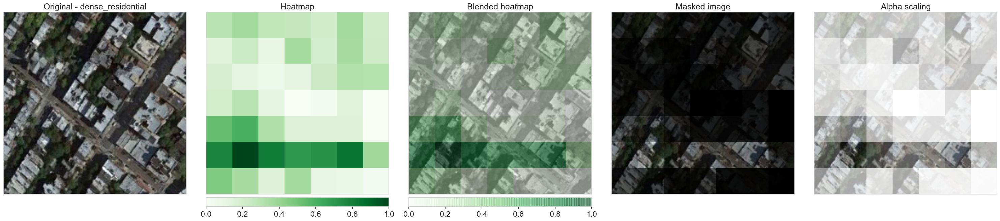

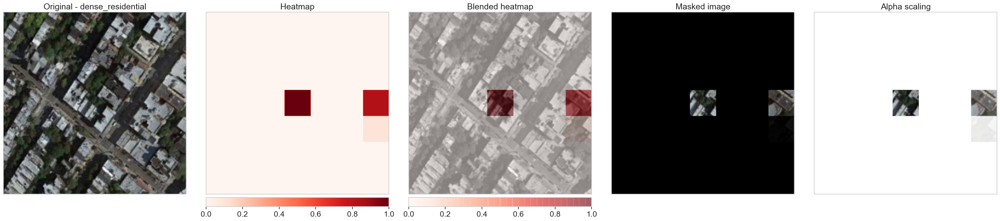

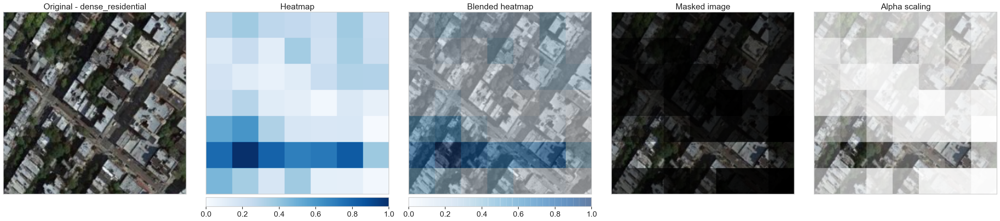

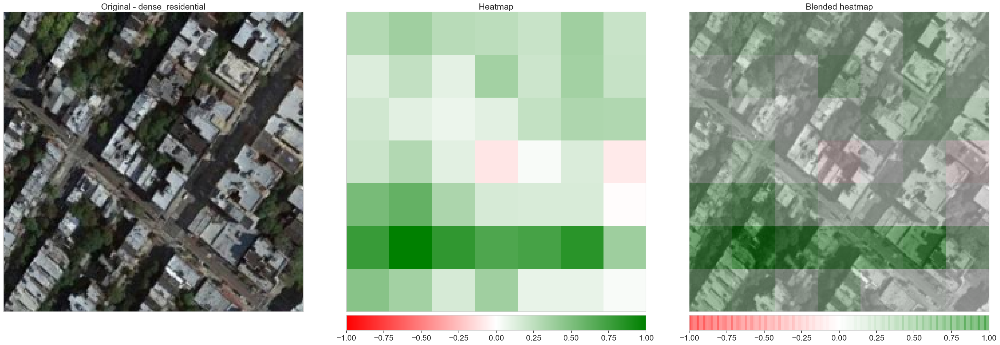

In [69]:
viz.visualize_image_attr_multiple(attributions, imagejpg, **methods, **signs_positive, **plot_kwargs, titles=['Original - ' + class_names[target], *titles])
viz.visualize_image_attr_multiple(attributions, imagejpg, outlier_perc=2, **methods, **signs_negative, **plot_kwargs, titles=['Original - ' + class_names[target], *titles])
viz.visualize_image_attr_multiple(attributions, imagejpg, outlier_perc=2, **methods, **signs_absolute, **plot_kwargs, titles=['Original - ' + class_names[target], *titles])
viz.visualize_image_attr_multiple(attributions, imagejpg, outlier_perc=2, **methods_, **signs_all, **plot_kwargs, titles=['Original - ' + class_names[target], *titles_])
plt.show();

In [71]:
# dla innej klasy
target = 15

attributions_ = gradcam.attribute(input_batch, target=target)
attributions = LayerAttribution.interpolate(attributions_, (imagejpg.shape[0], imagejpg.shape[1]))
attributions = np.transpose(attributions.squeeze(0).cpu().detach().numpy(), (1, 2, 0))

In [73]:
class_names[target]

'golf_course'

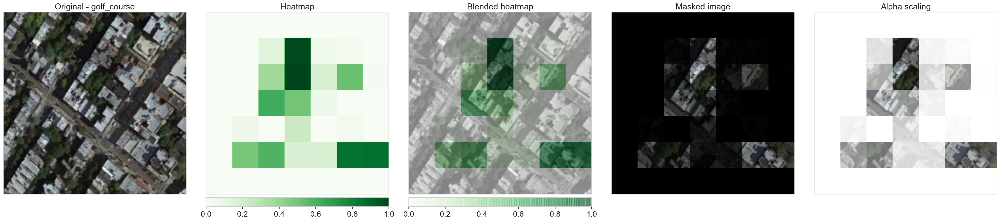

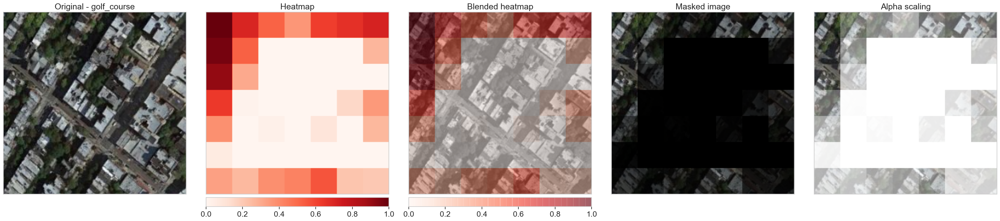

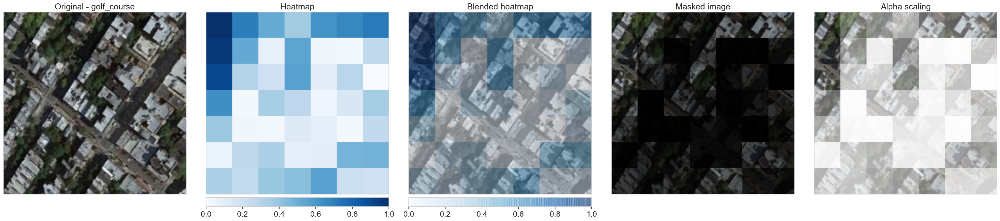

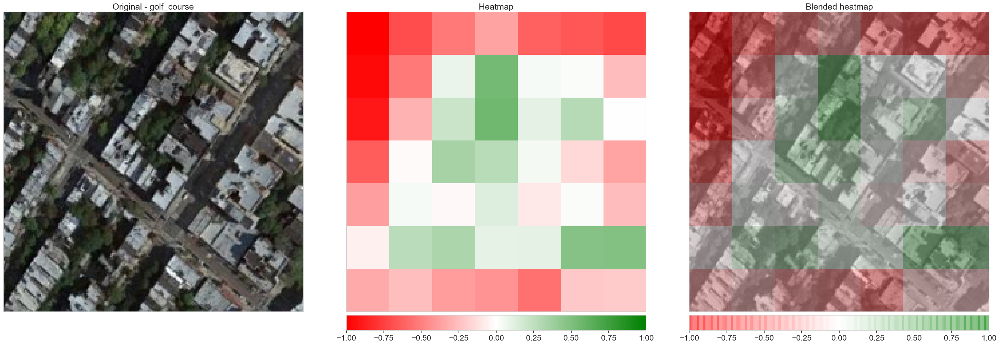

In [72]:
viz.visualize_image_attr_multiple(attributions, imagejpg, **methods, **signs_positive, **plot_kwargs, titles=['Original - ' + class_names[target], *titles])
viz.visualize_image_attr_multiple(attributions, imagejpg, outlier_perc=2, **methods, **signs_negative, **plot_kwargs, titles=['Original - ' + class_names[target], *titles])
viz.visualize_image_attr_multiple(attributions, imagejpg, outlier_perc=2, **methods, **signs_absolute, **plot_kwargs, titles=['Original - ' + class_names[target], *titles])
viz.visualize_image_attr_multiple(attributions, imagejpg, outlier_perc=2, **methods_, **signs_all, **plot_kwargs, titles=['Original - ' + class_names[target], *titles_])
plt.show();

In [77]:
## Guided GRadCAM
target = 11

In [101]:
guided_gradcam = GuidedGradCam(model, model.layer4[-1])
attributions = guided_gradcam.attribute(input_batch, target=target)

attributions.shape, attributions.dtype

(torch.Size([1, 3, 224, 224]), torch.float32)

In [79]:
attributions = np.transpose(attributions.squeeze(0).cpu().detach().numpy(), (1, 2, 0))

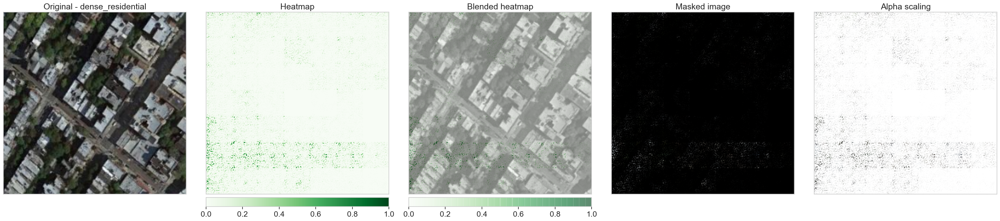

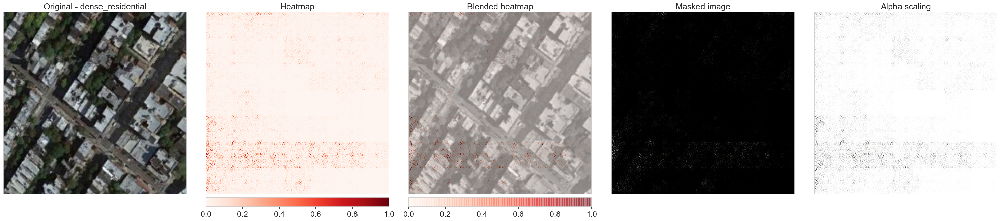

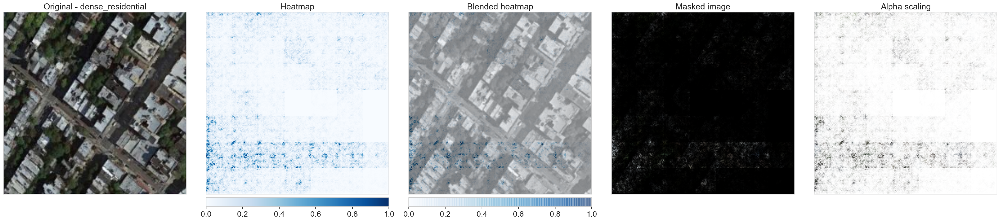

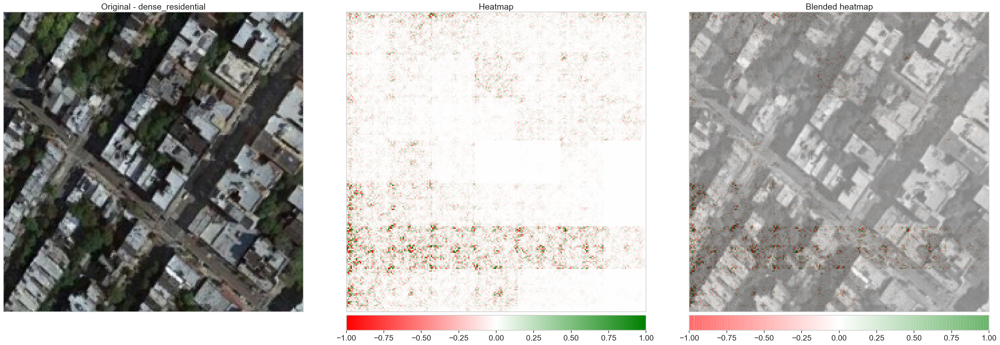

In [80]:
viz.visualize_image_attr_multiple(attributions, imagejpg, **methods, **signs_positive, **plot_kwargs, titles=['Original - ' + class_names[target], *titles]);
viz.visualize_image_attr_multiple(attributions, imagejpg, **methods, **signs_negative, **plot_kwargs, titles=['Original - ' + class_names[target], *titles]);
viz.visualize_image_attr_multiple(attributions, imagejpg, **methods, **signs_absolute, **plot_kwargs, titles=['Original - ' + class_names[target], *titles]);
viz.visualize_image_attr_multiple(attributions, imagejpg, **methods_, **signs_all, **plot_kwargs, titles=['Original - ' + class_names[target], *titles_]);
plt.show();